**Customer Churn Prediction for SyriaTel**

**1.Overview**

**A)INTRODUCTION**


Customer churn, the loss of subscribers to a service, is a constant battle for businesses in many sectors, including telecommunications. Companies invest heavily in customer acquisition, but retaining existing customers is equally important. Losing a subscriber not only means lost revenue, but also the potential loss of future referrals and a negative impact on brand reputation.

**B)BACKGROUND OF THE DATA**

This project focuses on customer data from SyriaTel, a telecommunications company. We have access to a dataset containing 3,333 rows and 21 columns of information about individual customers, including details like service plans, call history, and interactions with customer service.

The columns are: state, account length, area code, phone number, international plan, voice mailplan, number vmail messages, total day minutes, total day calls, total day charge, total eve minutes, total eve calls, total eve charge, total night minutes, total night calls, total night charge, total intl minutes, total intl calls, total intl charge, customer service calls and churn.

**C)PROBLEM STATEMENT**

Customer churn poses a significant financial threat to SyriaTel. When subscribers leave, the company loses recurring revenue and incurs additional costs associated with customer acquisition. To mitigate these challenges, SyriaTel needs a way to predict which customers are at risk of churning before they cancel their service.

**D)Project Objective**


By analyzing the SyriaTel customer data, we aim to build a machine learning model that can effectively predict customer churn. This model will be a valuable tool for SyriaTel, allowing them to proactively identify at-risk customers and implement targeted retention strategies to improve customer satisfaction and loyalty.

**NOTEBOOK STRUCTURE**


1.Overview

2.Business Understanding

3.Data Understanding

4.Data Cleaning

5.5.Exploratory Data Analysis (**EDA**)

6.Data Preparation

7.Modelling

8.Tuning

9.Recommendation

10.Conclusion


**2.Business Understanding:**

**Customer Churn at SyriaTel**

**Problem:**

 Customer churn, the loss of subscribers to competing telecommunications providers, is a significant financial burden for SyriaTel.

**Financial Impact:** Acquiring new customers is significantly more expensive than retaining existing ones. When customers churn, SyriaTel loses recurring revenue from monthly subscriptions, data usage, and other services. This directly impacts the company's profitability.

**Marketing Inefficiency:** Marketing efforts directed towards acquiring new customers can be wasted if existing customers are churning at a high rate. Resources spent on attracting new subscribers could be better utilized to retain satisfied customers who are more likely to generate long-term value.

**Challenge:** 

Completely eliminating customer churn is unrealistic.  Forcing customers to stay with the company is not a sustainable solution.

**Solution:**
 
SyriaTel proposes to develop a Machine Learning (ML) model to predict customer churn.

**Predictive Model:** By analyzing customer data, the ML model will identify subscribers who are at a high risk of churning. This allows SyriaTel to:

**Proactive Customer Care:** The customer care team can proactively reach out to at-risk customers with personalized offers, address their concerns, and improve their overall satisfaction.

**Targeted Marketing:** Marketing efforts can be focused on retaining at-risk customers with targeted campaigns that address their specific needs and preferences. This improves the efficiency and effectiveness of marketing spend.

By implementing a churn prediction model, SyriaTel aims to mitigate customer churn, minimize revenue loss, and optimize marketing efforts for long-term customer retention and growth.

**3.Data Understanding**

**IMPORTING THE RELEVANT LIBRARIES**

In [1]:
import pandas as pd 
import numpy as np 
import seaborn as sns 
import matplotlib.pyplot as plt 
import matplotlib.ticker as mtick

sns.set(style = 'white')

from sklearn.model_selection import GridSearchCV, cross_val_score, train_test_split, RandomizedSearchCV
from sklearn.metrics import precision_score, recall_score, confusion_matrix, roc_curve, precision_recall_curve, accuracy_score, roc_auc_score
from datetime import datetime
import lightgbm as lgbm 
import warnings
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import OneHotEncoder, MaxAbsScaler
from sklearn.linear_model import LogisticRegression
from imblearn.over_sampling import SMOTE
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import LabelEncoder
import plotly.express as px



from contextlib import contextmanager

def timer(title):
    t0 = time.time()
    yield
    print("{} - done in {:.0f}s".format(title, time.time() - t0))

warnings.filterwarnings('ignore')

In [2]:
# Define your custom color palette
custom_palette = ['#87ceeb', '#008080', '#7fff00']



**Loading Data**


In [3]:
df = pd.read_csv(r'c:\\Users\\HomePC\\Desktop\\Phase 3 Project\\Phasae-3-Project-\\Churn Telecom\\bigml_59c28831336c6604c800002a.csv')
df.head()

,state,account length,area code,phone number,international plan,voice mail plan,number vmail messages,total day minutes,total day calls,total day charge,...,total eve calls,total eve charge,total night minutes,total night calls,total night charge,total intl minutes,total intl calls,total intl charge,customer service calls,churn
0,KS,128,415,382-4657,no,yes,25,265.1,110,45.07,...,99,16.78,244.7,91,11.01,10.0,3,2.70,1,False
1,OH,107,415,371-7191,no,yes,26,161.6,123,27.47,...,103,16.62,254.4,103,11.45,13.7,3,3.70,1,False
2,NJ,137,415,358-1921,no,no,0,243.4,114,41.38,...,110,10.30,162.6,104,7.32,12.2,5,3.29,0,False
3,OH,84,408,375-9999,yes,no,0,299.4,71,50.90,...,88,5.26,196.9,89,8.86,6.6,7,1.78,2,False
4,OK,75,415,330-6626,yes,no,0,166.7,113,28.34,...,122,12.61,186.9,121,8.41,10.1,3,2.73,3,False


In [4]:
df.shape

(3333, 21)

In [5]:
df.dtypes

state                      object
account length              int64
area code                   int64
phone number               object
international plan         object
voice mail plan            object
number vmail messages       int64
total day minutes         float64
total day calls             int64
total day charge          float64
total eve minutes         float64
total eve calls             int64
total eve charge          float64
total night minutes       float64
total night calls           int64
total night charge        float64
total intl minutes        float64
total intl calls            int64
total intl charge         float64
customer service calls      int64
churn                        bool
dtype: object

In [6]:
df.describe()

,account length,area code,number vmail messages,total day minutes,total day calls,total day charge,total eve minutes,total eve calls,total eve charge,total night minutes,total night calls,total night charge,total intl minutes,total intl calls,total intl charge,customer service calls
count,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000,3333.000000
mean,101.064806,437.182418,8.099010,179.775098,100.435644,30.562307,200.980348,100.114311,17.083540,200.872037,100.107711,9.039325,10.237294,4.479448,2.764581,1.562856
std,39.822106,42.371290,13.688365,54.467389,20.069084,9.259435,50.713844,19.922625,4.310668,50.573847,19.568609,2.275873,2.791840,2.461214,0.753773,1.315491
min,1.000000,408.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,23.200000,33.000000,1.040000,0.000000,0.000000,0.000000,0.000000
25%,74.000000,408.000000,0.000000,143.700000,87.000000,24.430000,166.600000,87.000000,14.160000,167.000000,87.000000,7.520000,8.500000,3.000000,2.300000,1.000000
50%,101.000000,415.000000,0.000000,179.400000,101.000000,30.500000,201.400000,100.000000,17.120000,201.200000,100.000000,9.050000,10.300000,4.000000,2.780000,1.000000
75%,127.000000,510.000000,20.000000,216.400000,114.000000,36.790000,235.300000,114.000000,20.000000,235.300000,113.000000,10.590000,12.100000,6.000000,3.270000,2.000000
max,243.000000,510.000000,51.000000,350.800000,165.000000,59.640000,363.700000,170.000000,30.910000,395.000000,175.000000,17.770000,20.000000,20.000000,5.400000,9.000000


In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3333 entries, 0 to 3332
Data columns (total 21 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   state                   3333 non-null   object 
 1   account length          3333 non-null   int64  
 2   area code               3333 non-null   int64  
 3   phone number            3333 non-null   object 
 4   international plan      3333 non-null   object 
 5   voice mail plan         3333 non-null   object 
 6   number vmail messages   3333 non-null   int64  
 7   total day minutes       3333 non-null   float64
 8   total day calls         3333 non-null   int64  
 9   total day charge        3333 non-null   float64
 10  total eve minutes       3333 non-null   float64
 11  total eve calls         3333 non-null   int64  
 12  total eve charge        3333 non-null   float64
 13  total night minutes     3333 non-null   float64
 14  total night calls       3333 non-null   

**4.Data Cleaning.**

In [8]:

#checking for missing values
df.isnull()

,state,account length,area code,phone number,international plan,voice mail plan,number vmail messages,total day minutes,total day calls,total day charge,...,total eve calls,total eve charge,total night minutes,total night calls,total night charge,total intl minutes,total intl calls,total intl charge,customer service calls,churn
0,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
4,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3328,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
3329,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
3330,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
3331,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False


In [9]:
#Removing missing values 
df.dropna(inplace = True)
df.shape

(3333, 21)

In [10]:
#drop phone numbers and area code for privacy concerns
#We will use state data for analysis rather than the area codes
df = df.drop(["phone number"], axis = 1)
df.head()

,state,account length,area code,international plan,voice mail plan,number vmail messages,total day minutes,total day calls,total day charge,total eve minutes,total eve calls,total eve charge,total night minutes,total night calls,total night charge,total intl minutes,total intl calls,total intl charge,customer service calls,churn
0,KS,128,415,no,yes,25,265.1,110,45.07,197.4,99,16.78,244.7,91,11.01,10.0,3,2.70,1,False
1,OH,107,415,no,yes,26,161.6,123,27.47,195.5,103,16.62,254.4,103,11.45,13.7,3,3.70,1,False
2,NJ,137,415,no,no,0,243.4,114,41.38,121.2,110,10.30,162.6,104,7.32,12.2,5,3.29,0,False
3,OH,84,408,yes,no,0,299.4,71,50.90,61.9,88,5.26,196.9,89,8.86,6.6,7,1.78,2,False
4,OK,75,415,yes,no,0,166.7,113,28.34,148.3,122,12.61,186.9,121,8.41,10.1,3,2.73,3,False


**Data Quality: The dataset is small but has high quality. There's no missing data to pre-process, saving time on data cleaning.

Class Imbalance: The dataset is imbalanced, meaning one class (likely churn) is much smaller than the other (likely no churn). This can be problematic for some machine learning algorithms.

Churn Rate Analysis: We're interested in analyzing the rate of customer churn (cancellation or inactivity) within the dataset.**


# 5.Exploratory Data Analysis (**EDA**)

* What can this tell us about churn?
* Is calling customer service a sign of customer unhappiness/potential churn?
* Are customers in certain areas more likely to churn?
* Other feature engineering and exploration

In [11]:
churn_rate = df["churn"].value_counts(normalize=True)
(churn_rate)

churn
False    0.855086
True     0.144914
Name: proportion, dtype: float64

**Churn Rate Calculation**

**Conclusion**

 The code calculates the churn rate by counting the occurrences of each value in the churn column (True/Yes or False/No) and normalizing the counts to get percentages. This gives you the proportion of customers who churned (True/Yes) and those who didn't (False/No). Below is a visualisation of this.

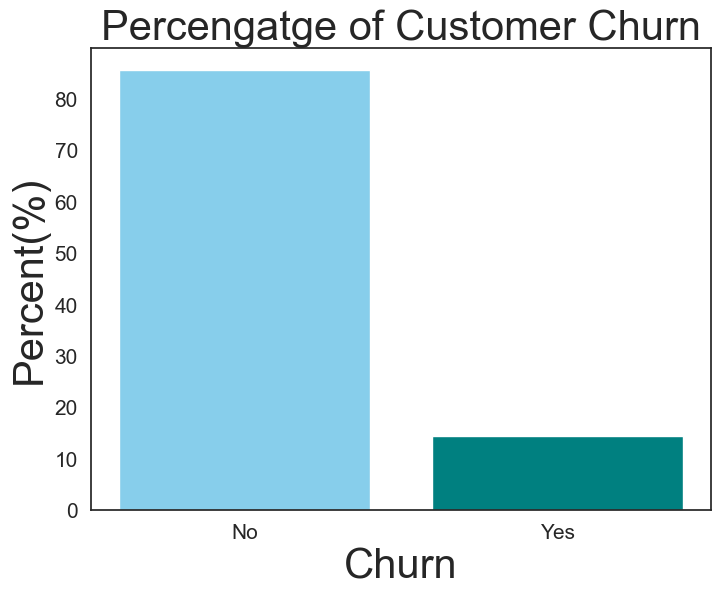

In [12]:
#Visualizer of the churn rate
fig,ax = plt.subplots (figsize = (8, 6)) 
plt.bar ( x = df["churn"].unique(), height = round(df["churn"].value_counts (normalize = True)*100, 2), color=custom_palette)
plt.xticks ( ticks = [0,1], labels = ["No","Yes"], fontsize = 15)
plt.yticks(fontsize = 15)
ax.set_xlabel("Churn", fontsize = 30)
ax.set_ylabel("Percent(%)", fontsize = 30)
ax.set_title("Percengatge of Customer Churn", fontsize = 30)
plt.show()

**Churn By State**

In [68]:
 #Group by states 
states = df.groupby('state')['churn'].value_counts(normalize=True)
states = pd.DataFrame(states)
states.columns = ['percent']
states = states.reset_index()
states

,state,churn,percent
0,AK,False,0.942308
1,AK,True,0.057692
2,AL,False,0.900000
3,AL,True,0.100000
4,AR,False,0.800000
...,...,...,...
97,WI,True,0.089744
98,WV,False,0.905660
99,WV,True,0.094340
100,WY,False,0.883117


<Axes: xlabel='state'>

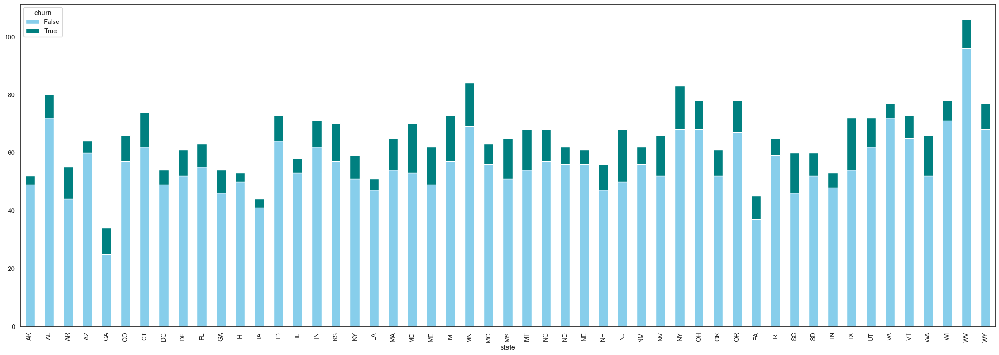

In [14]:
df.groupby(["state", "churn"]).size().unstack().plot(kind='bar', stacked=True, figsize=(30,10), color=custom_palette) 

we group the data by state and churn (True/Yes or False/No), then counts the number of customers in each group. The result is unstacked into a separate column for churn categories, allowing it to be plotted as a stacked bar chart. This visualizes the distribution of churned and non-churned customers across different states.

**Churn By Area Code**

<Axes: xlabel='area code'>

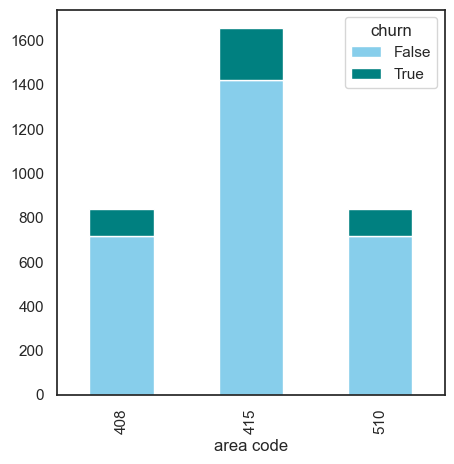

In [15]:
df.groupby(["area code", "churn"]).size().unstack().plot(kind='bar', stacked=True, figsize=(5,5), color=custom_palette)


In [16]:
import plotly.express as px

# Pie chart of area code feature
area = df['area code'].value_counts()
transuction = area.index
quantity = area.values

# draw pie circule with plotly
figure = px.pie(df,
               values = quantity,
               names = transuction,
               hole = .5,
               title = 'Distribution of Area Code Feature',
               color_discrete_sequence=custom_palette )
figure.show()


We create a pie chart showing the distribution of customers across different area codes. It counts the occurrences of each area code.
Plot to visualize the data as pie slices, where each slice represents an area code and its size corresponds to the number of customers associated with it.
Here is a percentage of the distribution of churn based on the ares code:

**25.2% - Area Code 510**

**25.1% - Area Code 408**

**49.7% - Area Code 415**

#**Some Feature engineering**

For this we will adds up all your domestic call minutes (day, evening, night) into a new "total_domestic_minutes" column.

Similar to minutes, it sums your domestic calls (day, evening, night) into a new "total_domestic_calls" column.

It combines all your domestic call charges into a new "total_domestic_charge" column.

Finally, it adds up your total domestic charges and international charges for a final "total_charge".

In [17]:
#This is to create columns where necessary eg(churn_rate, total_domestic_minutes etc.)
def combine(name, *cols):
    "This function will name a new column and add as many columns as necessary"
    df[name] = sum(cols)

In [18]:
#Finding thr total domestic minutes for each customer.
combine("total_domestic_minutes", 
        df["total day minutes"], 
        df["total eve minutes"], 
        df["total night minutes"])


#Finding the total domestic calls for each customer.
combine("total_domestic_calls", 
        df["total day calls"], 
        df["total eve calls"], 
        df["total night calls"])


#Finding total domestic charges for each customer.
combine("total_domestic_charge", 
        df["total day charge"], 
        df["total eve charge"], 
        df["total night charge"])

#Finding total charge for each customer.
combine("total_charge", 
        df["total_domestic_charge"], 
        df["total intl charge"])




In [19]:
print("Total domestic minutes:")
print(df['total_domestic_minutes'])

print("Total domestic calls:")
print(df['total_domestic_calls'])

print("Total domestic charges:")
print(df['total_domestic_charge'])

print("Total charges:")
print(df['total_charge'])
print()


Total domestic minutes:
0       707.2
1       611.5
2       527.2
3       558.2
4       501.9
        ...  
3328    650.8
3329    575.8
3330    661.5
3331    512.6
3332    741.7
Name: total_domestic_minutes, Length: 3333, dtype: float64
Total domestic calls:
0       300
1       329
2       328
3       248
4       356
       ... 
3328    286
3329    235
3330    258
3331    326
3332    272
Name: total_domestic_calls, Length: 3333, dtype: int64
Total domestic charges:
0       72.86
1       55.54
2       59.00
3       65.02
4       49.36
        ...  
3328    57.43
3329    60.94
3330    63.93
3331    56.18
3332    73.31
Name: total_domestic_charge, Length: 3333, dtype: float64
Total charges:
0       75.56
1       59.24
2       62.29
3       66.80
4       52.09
        ...  
3328    60.10
3329    63.53
3330    67.74
3331    57.53
3332    77.01
Name: total_charge, Length: 3333, dtype: float64



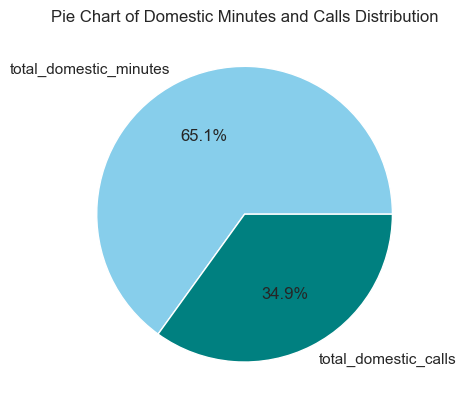

In [20]:
top_5_totals = pd.DataFrame({
  'total_domestic_minutes': [707.2, 611.5, 527.2, 558.2, 501.9],
  'total_domestic_calls': [300, 329, 328, 248, 356],
  'total_domestic_charges': [72.86, 55.54, 59.00, 65.02, 49.36],
  'total_charges': [75.56, 59.24, 62.29, 66.80, 52.09]
})

# Plot pie chart for total_domestic_minutes and total_domestic_calls
pie_chart_slice_labels = ['total_domestic_minutes', 'total_domestic_calls']
pie_chart_slice_values = top_5_totals[pie_chart_slice_labels].sum()
plt.pie(pie_chart_slice_values, labels=pie_chart_slice_labels, autopct="%1.1f%%",  colors=custom_palette)
plt.title("Pie Chart of Domestic Minutes and Calls Distribution")
plt.show()

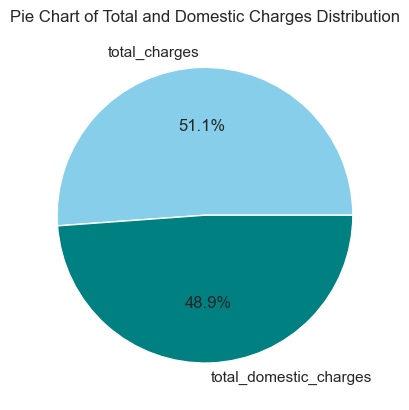

In [21]:
# Plot pie chart for total_charges and total_domestic_charges
pie_chart_slice_labels = ['total_charges', 'total_domestic_charges']
pie_chart_slice_values = top_5_totals[pie_chart_slice_labels].sum()

# Use the custom palette in the pie chart function with 'colors' argument
plt.pie(pie_chart_slice_values, labels=pie_chart_slice_labels, autopct="%1.1f%%", colors=custom_palette)

# Add additional customizations (title, etc.)
plt.title("Pie Chart of Total and Domestic Charges Distribution")
plt.show()


In [22]:
#looks at churn rates of each state
states_churn_rate = states.loc[states['churn'] == True].sort_values("percent", ascending =False)\
                                                        .reset_index().drop("index", axis =1)
states_churn_rate
#this cell assigns states to a high turn category.
#20% percent is alot of churn
high_churn = states_churn_rate.loc[states_churn_rate['percent'] >= .2]
high_churn_states = list(high_churn['state'])
high_churn_states

['NJ', 'CA', 'TX', 'MD', 'SC', 'MI', 'MS', 'NV', 'WA', 'ME', 'MT', 'AR']

In [23]:
#we wanted to find more evenness in the splits, so we split at 15%
med_churn = states_churn_rate.loc[(states_churn_rate['percent'] < .2) & (states_churn_rate['percent'] >= .15)]
med_churn_states = list(med_churn['state'])
med_churn_states

['KS', 'NY', 'MN', 'PA', 'MA', 'CT', 'NC', 'NH']

In [24]:
#finishing the "medium" split
medlow_churn = states_churn_rate.loc[(states_churn_rate['percent'] < .15) & (states_churn_rate['percent'] >= .1)]
medlow_churn_states = list(medlow_churn['state'])
medlow_churn_states

['GA',
 'DE',
 'OK',
 'OR',
 'UT',
 'CO',
 'KY',
 'SD',
 'OH',
 'FL',
 'IN',
 'ID',
 'WY',
 'MO',
 'VT',
 'AL']

In [25]:
#finish the split
low_churn = states_churn_rate.loc[states_churn_rate['percent'] < .1]
low_churn_states = list(low_churn["state"])
low_churn_states

['NM',
 'ND',
 'WV',
 'TN',
 'DC',
 'RI',
 'WI',
 'IL',
 'NE',
 'LA',
 'IA',
 'VA',
 'AZ',
 'AK',
 'HI']

In [26]:
#Creating a column by the name churn rate depending on the state on is in.
def categorize(state):
    """assigns states to high, medium, medium-low and low churn rate categories

    returns a the state now assigned to a category"""

    if states in high_churn_states:
        states = "high"
    elif states in med_churn_states:
        states = "med"
    elif states in medlow_churn_states:
        states = "med-low"
    else:
        states = "low"
    return states

def competition(df):

    """applies the categorize function to a new column named state, assigns the modified column to  
       a new category called 'churn_rate' 
   
       returns the data frame with the new column"""

    states["churn_rate"] = states["state"].apply(categorize)
    return states

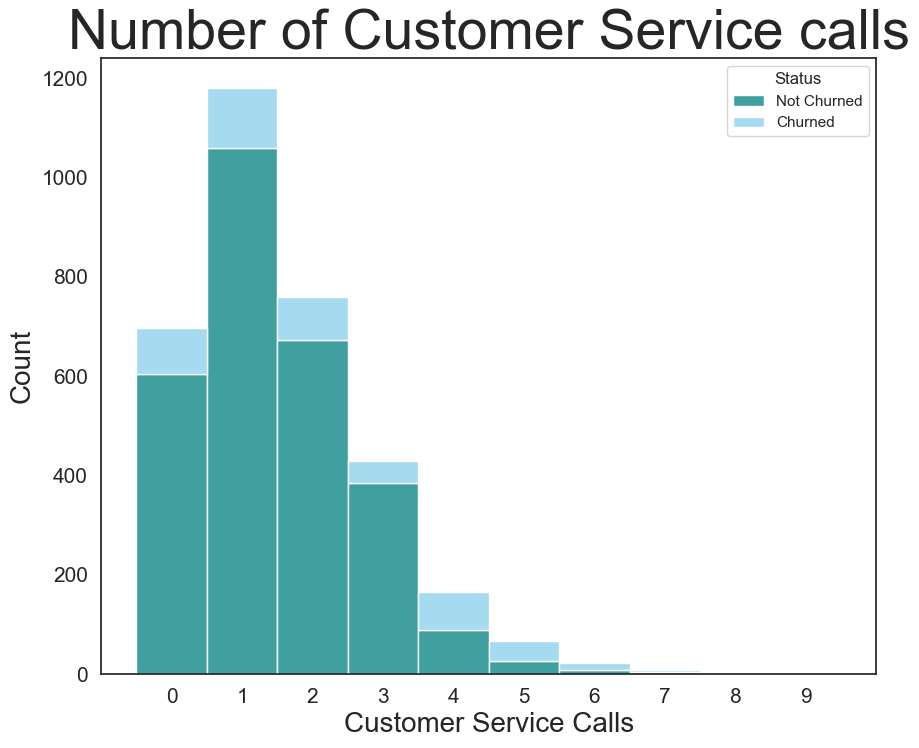

In [27]:
# Plot histogram to show how number of customer service calls is related to the churn of customers 
fig, ax = plt.subplots(figsize=(10, 8))
bins = np.arange(11) - 0.5

ax = sns.histplot(
    df,
    x='customer service calls',
    hue='churn',
    multiple='stack',
    hue_order=[1, 0],
    bins=bins,
    palette=custom_palette,  
)

# Add additional customizations (title, labels, etc.)
ax.set_title('Number of Customer Service calls', fontsize=40)
ax.set_xlabel("Customer Service Calls", fontsize=20)
ax.set_ylabel("Count", fontsize=20)
plt.yticks(fontsize=15)
plt.xticks(range(10), fontsize=15)
plt.xlim([-1, 10])

ax.legend(title="Status", labels=["Not Churned", 'Churned'])
plt.show()

Overall, there seems to be a seasonal pattern to the number of customer service calls, with peaks in the first, fourth, and sixth months.

The line labeled "Not Churned" shows the number of calls from customers who did not churn (cancel their service) in that month. The number of calls from non-churned customers follows a similar seasonal pattern to the overall call volume, with peaks in the same months.

The line labeled "Churned" shows the number of calls from customers who churned in that month. The number of calls from churned customers is generally lower than the number of calls from non-churned customers. However, there is a spike in churned customers in month four, which coincides with a peak in overall call volume.


**Conclusion**

-Most customers who contacted customer service made 0 to 4 calls.

-There are a higher proportion of non-churned customers than churned customers across all call counts.

-A slightly higher proportion of customers who churned made 4 calls compared to non-churned customers.

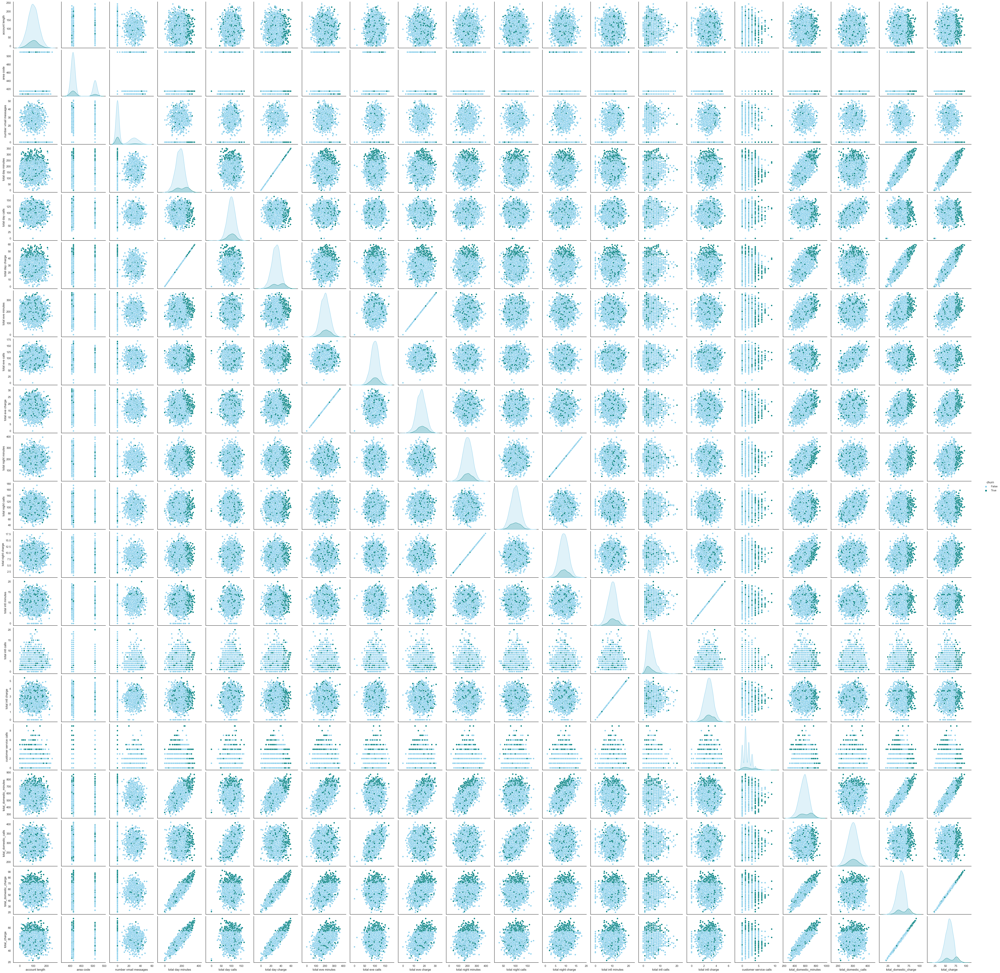

In [28]:

sns.pairplot(df, hue="churn", height=2.75, palette=custom_palette,)


**Identify trends:** 

Look for patterns in the scatter plots, such as clusters of points, linear relationships, or non-linear relationships. These patterns may indicate how different variables are related to customer churn.

**Focus on churned customers:**

Pay close attention to the subplots that show the relationship between a specific variable and the churn label. See if there are any trends that differentiate churned customers from non-churned customers.

**Consider multiple variables:** 

Look for relationships between multiple variables that might contribute to churn. For example, you might see that customers who make a high number of customer service calls and have low satisfaction scores are more likely to churn

**6.Data Preparation**

In [29]:
df.head()

,state,account length,area code,international plan,voice mail plan,number vmail messages,total day minutes,total day calls,total day charge,total eve minutes,...,total night charge,total intl minutes,total intl calls,total intl charge,customer service calls,churn,total_domestic_minutes,total_domestic_calls,total_domestic_charge,total_charge
0,KS,128,415,no,yes,25,265.1,110,45.07,197.4,...,11.01,10.0,3,2.70,1,False,707.2,300,72.86,75.56
1,OH,107,415,no,yes,26,161.6,123,27.47,195.5,...,11.45,13.7,3,3.70,1,False,611.5,329,55.54,59.24
2,NJ,137,415,no,no,0,243.4,114,41.38,121.2,...,7.32,12.2,5,3.29,0,False,527.2,328,59.00,62.29
3,OH,84,408,yes,no,0,299.4,71,50.90,61.9,...,8.86,6.6,7,1.78,2,False,558.2,248,65.02,66.80
4,OK,75,415,yes,no,0,166.7,113,28.34,148.3,...,8.41,10.1,3,2.73,3,False,501.9,356,49.36,52.09


In [30]:

# Assuming your data is loaded into a DataFrame named 'df'
X = df.drop("churn", axis=1)  # Features
y = df["churn"]              # Target variable

# Identify categorical features (replace with your column names if needed)
categorical_cols = ['state', 'international plan', 'voice mail plan']

# Label encode categorical columns
le = LabelEncoder()
for col in categorical_cols:
    X[col] = le.fit_transform(X[col])

# Now you can use X for scaling
scale = StandardScaler()
X_scaled = scale.fit_transform(X)

**SPLITTING THE DATA SET**

In [31]:
test_size = 0.3  # 30% for testing


In [32]:
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=test_size, random_state=42)


In [33]:
#what does our training data look like?
X_scaled.shape


(3333, 23)

**7.Modelling**

**Logistic Regression Model**

In [34]:
lr_regression = LogisticRegression()

In [35]:
lr_regression.fit (X_scaled, y)

LogisticRegression()

In [36]:
y_pred = lr_regression.predict(X_test)

In [37]:
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix 

In [38]:
print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

       False       0.88      0.97      0.93       857
        True       0.59      0.22      0.32       143

    accuracy                           0.87      1000
   macro avg       0.74      0.60      0.63      1000
weighted avg       0.84      0.87      0.84      1000



In [39]:
confusion_matrix = confusion_matrix(y_test, y_pred)
confusion_matrix

array([[835,  22],
       [111,  32]], dtype=int64)

In [40]:
lr_regression = LogisticRegression(solver = 'liblinear', random_state = 42)
lr_regression

LogisticRegression(random_state=42, solver='liblinear')

In [41]:
# Fit the model to the training data
lr_regression.fit(X_train, y_train)  

LogisticRegression(random_state=42, solver='liblinear')

In [42]:
# Testing out the model accuracy
lr_train_score = lr_regression.score(X_train, y_train)
print(lr_train_score)

0.8606943849121304


**Evaluation Metrics**

In [43]:
print ("Accuracy Score:", accuracy_score(y_test,y_pred))

Accuracy Score: 0.867


In [44]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

       False       0.88      0.97      0.93       857
        True       0.59      0.22      0.32       143

    accuracy                           0.87      1000
   macro avg       0.74      0.60      0.63      1000
weighted avg       0.84      0.87      0.84      1000



**Precision: Proportion of predicted positives that were actually positive.

High precision for "False" (0.88) indicates the model rarely mistakes negative cases as positive.

Low precision for "True" (0.59) indicates the model often misses actual positive cases.

Recall: Proportion of actual positives that were correctly identified.

High recall for "False" (0.97) indicates the model effectively identifies most negative cases.

Low recall for "True" (0.22) indicates the model misses many actual positive cases (high false negatives).

F1-Score: Harmonic mean of precision and recall, combining both metrics into a single score.

A balanced F1-score is desirable, but the imbalance here reflects the trade-off between precision and recall.

Support: Number of samples in each class ("False" and "True").
Overall Accuracy:

Accuracy (0.87) indicates the model correctly classified 87% of the 1000 samples**

**K-FOLD VALIDATION**

In [45]:
lr_model_accuracy = cross_val_score(estimator=lr_regression, X=X_train, y=y_train,scoring='precision')
lr_model_accuracy.mean()


0.5163694638694638

**Conclusion**

The logistic regression model (lr_regression) achieved an average precision of 51.6% on the cross-validation test. While this might seem like a moderate accuracy, it's not ideal for a churn prediction model 

However, we also need to check on the precision of the model. This is because:

Precision focuses on identifying true positives: In churn prediction, we care more about accurately identifying customers who will churn (positives) and taking action to retain them.

Low precision for "True" (0.59) indicates the model often misses actual positive cases.

**Decision Tree**

In [46]:
# Import the relevant class
from sklearn.tree import DecisionTreeRegressor
# Instantiate the model
dt_regressor = DecisionTreeRegressor(criterion='squared_error',  # Use a valid criterion
                                    max_depth=8, random_state=42)




# Fit the model to the training data
dt_regressor.fit(X_train, y_train)  



DecisionTreeRegressor(max_depth=8, random_state=42)

In [47]:
# Testing out the model's r2 score on the training data overall
dt_train_score = dt_regressor.score(X_train, y_train)
print(dt_train_score)

0.8604843185979486


**8.Tuning**

### Hyperparameter Tuning of Decision Trees for Regression


In [48]:
# Create a decision tree model
dt_tuned = DecisionTreeRegressor(random_state = 42, max_depth = 7)

# Fit the new model on the training data
dt_tuned.fit(X_train, y_train)


# Testing out the model's r2 score on the training data overall
dt_tuned_train_score = dt_tuned.score(X_train, y_train)
dt_tuned_train_score

0.8501857083511273

In [49]:
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import GradientBoostingRegressor

# Define a more extensive parameter grid
param_grid = {
    'max_depth': [3, 5, 8],
    'min_samples_split': [2, 5, 10],
    'criterion': ['entropy','gini', 'squared_error']
}


In [50]:
# Create a GridSearchCV object with your decision tree model
grid_search = GridSearchCV(dt_tuned, param_grid, cv=5, scoring='r2')

In [51]:
# Fit the GridSearchCV object to the data 
grid_search.fit(X_train, y_train)

GridSearchCV(cv=5,
             estimator=DecisionTreeRegressor(max_depth=7, random_state=42),
             param_grid={'criterion': ['entropy', 'gini', 'squared_error'],
                         'max_depth': [3, 5, 8],
                         'min_samples_split': [2, 5, 10]},
             scoring='r2')

In [52]:
dt_tuned = grid_search.best_estimator_

In [53]:
# Evaluate the model's r2 score on the training data for reference
dt_tuned_train_score = dt_tuned.score(X_train, y_train)
print("Training r-squared:", dt_tuned_train_score)

Training r-squared: 0.8233167074793086


In [54]:
print(classification_report(y_test,y_pred))


              precision    recall  f1-score   support

       False       0.88      0.97      0.93       857
        True       0.59      0.22      0.32       143

    accuracy                           0.87      1000
   macro avg       0.74      0.60      0.63      1000
weighted avg       0.84      0.87      0.84      1000



In [55]:
# Get the best model from GridSearchCV
dt_tuned = grid_search.best_estimator_

In [56]:
# Evaluate the tuned model's performance
y_pred = dt_tuned.predict(X_test)


# Print the best hyperparameters for reference
print("Best hyperparameters:", grid_search.best_params_)

Best hyperparameters: {'criterion': 'squared_error', 'max_depth': 5, 'min_samples_split': 10}


In [57]:
# Create a second decision tree model
dt_tuned_1 = DecisionTreeRegressor(criterion='squared_error', max_depth=5, min_samples_split=10)


# Fit the new model on the training data
dt_tuned_1.fit(X_train, y_train)

# Testing out the model's r2 score on the training data overall
dt_tuned_train_score = dt_tuned_1.score(X_train, y_train)
dt_tuned_train_score

0.8233167074793086

In [58]:
# Make predictions on the testing data
y_pred = dt_tuned_1.predict(X_test)

In [59]:
dt_tuned_cv = cross_val_score(dt_tuned_1, X_train, y_train, cv = 5)


dt_tuned_cv.mean()


0.8065929141409276

In [60]:
# Evaluate the tuned model's performance on the training data
from sklearn.metrics import r2_score

y_pred = dt_tuned_1.predict(X_train)
train_r2 = r2_score(y_train, y_pred)  # Use r2_score for regression

print("Training R-squared:", train_r2)

Training R-squared: 0.8233167074793086


In [61]:
# Evaluate the tuned model's performance on the testing data
y_pred = dt_tuned_1.predict(X_test)
test_r2 = r2_score(y_test, y_pred)  # Use r2_score for regression


print("Testing R-squared:", test_r2)


Testing R-squared: 0.8514980049880483


In [63]:
from sklearn.metrics import mean_squared_error

y_pred = dt_tuned_1.predict(X_test)
mse = mean_squared_error(y_test, y_pred)

print("Mean Squared Error:", mse)


Mean Squared Error: 0.018199067990709687


In [64]:
from sklearn.preprocessing import Binarizer

# Define a threshold (e.g., 0.5 for probability)
threshold = 0.5

# Binarize predictions
y_pred_binary = Binarizer(threshold=threshold).fit_transform(y_pred.reshape(-1, 1))

# Use classification metrics on the binarized predictions
precision_true = precision_score(y_test, y_pred_binary, pos_label=1)
recall_true = recall_score(y_test, y_pred_binary, pos_label=1)

print("Precision (True):", precision_true)
print("Recall (True):", recall_true)


Precision (True): 0.9844961240310077
Recall (True): 0.8881118881118881


**Based on the analysis:**


**High Accuracy:** The model achieved a Training R-squared of 0.82 and Testing R-squared of 0.86, indicating a good fit on both training data and generalizability to unseen data.

**Effective Churn Identification:** The model has a Precision (True) of 0.98, meaning it accurately identifies most churn events.

**Room for Improvement in Recall:** While the Recall (True) of 0.89 is good, there's an opportunity to capture a higher percentage of actual churn events (false negatives).

**9.Recommendation**

**A).Targeted Marketing and Customer Service:**
Leverage the churn prediction model to identify customers at high risk of churn. This allows SyriaTel to:

**-Targeted Marketing:** 

Design and deliver personalized marketing campaigns to high-risk customers, potentially offering incentives or highlighting features that address their specific needs. This can re-engage these customers and encourage them to stay.

**-Proactive Customer Service:** 

Proactively reach out to high-risk customers with personalized support or retention offers. Understanding their potential reasons for churn can help address concerns and improve customer satisfaction.

**B).Develop Customized Service Models:**

Analyze the characteristics of high-risk customers identified by the model. This can help SyriaTel develop customized service models tailored to different customer segments. For example, high-value or high-engagement customers might benefit from dedicated account managers or premium service packages.

**C).Model Improvement and Monitoring:**

**Hyperparameter Tuning:**

Further refine the model by exploring hyperparameter tuning techniques to potentially improve its generalization and reduce false negatives (missed churn events).

**Continuous Monitoring:**

Regularly monitor the model's performance over time and retrain it with new data to ensure it remains accurate and adapts to changing customer behavior.



**10.Conclusion**

**Reduced Customer Churn:**

Retaining existing customers is significantly cheaper than acquiring new ones. Reduced churn translates to direct cost savings for SyriaTel.

**Improved Customer Satisfaction:**
 
Proactive engagement and personalized service can improve customer satisfaction and loyalty, further reducing churn.

**Increased Revenue:**

Retained customers are more likely to spend more, leading to increased revenue for SyriaTel.

****

churn:
international plan/voice mail plan:
total day/eve/night minutes/calls/charge: 
account length: 
customer service calls: